# About the Project

The coding challenge consists of data of sourcing items from July 2020 to May 2021. The challenge is to forecast the sourcing cost of the same items. Two dataset files are provided. The first file consists of training data i.e. data from July 2020 to May 2021 and the second file is of testing data i.e. the actual values of sourcing from June 2021.

The first six columns i.e. ProductType, Manufacturer, Area Code, Sourcing Channel, Product Size and Product Type are all categorical variables and their unique combination makes up a unique item to be sourced. After analysing the dataset a total of 96 unique combinations were found i.e. 96 unique items are usually sourced. There are limited number of feature combinations (including sourcing month). Elaborating the previous statement, the combination of features for many values of sourcing cost (target variable) will be the same, which is a challenge for traditional Machine Learning Regressors. Thus, I have chosen to explore and apply the Time series based machine Learning technique.

I have tried to analyse the periodic trends of each of the individual 96 items separately and forecast their sourcing cost in June 2021. The dataset comprises of multiple values for the same month for the same product. However, simple time series based forecasting models utilise only one value to forecast the future values. Thus I have used aggregation functions to aggregate the values for each month.

Traditional steps of time series forecasting have been followed and applied on the 96 items for all the 5 aggregation functions used. The aggregation functions used are: arithmatic mean, minimum, maximum, median and trimmed mean. Outlier analysis for individual 96 items and for each month i.e. (96*12 interations) was computationally heavy and time consuming. Thus, a simple way to exclude outliers is utilised. I have used the trimmed mean function to exclude the initial and final few values, assuming they are outliers.

The following approach will be computationally efficient for large data and by applying parallel processing.

## Section wise Description:
Imports: Import necessary Libraries

Load and explore data: Load training data and explore, convert it to necessary forms to solve the problem.

Visualize Time series and trends using decomposition of time series: Visualize the time series as well as the decomposed components, i.e. trends, seasonality and residue for all 96 items for all 5 aggregate functions. The additive model proved to describe the trend perfectly for the data.

Load Testing data: Load the test data and check if all 96 items are present. The test data has only 1 value for each of the unique item.

Check Stationarity: Check if time series are stationary before feeding them to the ARIMA model. All the time series for all items for all aggregation functions are stationary.

PACF Plots: Plots to visualise lags

ARIMA Forecasting: Forecast Values for June 2021 using ARIMA

Results: Analyse the performance of the model.
**Refer discussion part in the results section to know more about the result.**

# Imports

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose

# Load and Explore Data

In [2]:
train = pd.read_csv("training.csv")

print(train.head())

print(train.shape)

  ProductType Manufacturer Area Code Sourcing Channel Product Size  \
0        NTM3           X1       A28        WHOLESALE        Large   
1        NTM2           X1        A9           DIRECT        Large   
2        NTM3           X2       A20           DIRECT        Large   
3        NTM3           X1       A18        WHOLESALE        Small   
4        NTM2           X1       A28           DIRECT        Large   

  Product Type Month of Sourcing  Sourcing Cost  
0       Powder            May-21          10.16  
1       Powder            Oct-20         134.28  
2       Powder            Dec-20          12.46  
3       Powder            Feb-21         107.22  
4       Liquid            Nov-20         197.76  
(550176, 8)


In [3]:
unique_months = train['Month of Sourcing'].unique()
print(unique_months)
train['Month of Sourcing'] = pd.to_datetime(train['Month of Sourcing'], format='%b-%y')
print(type(train['Month of Sourcing'][0]))
unique_months = train['Month of Sourcing'].unique()
print(len(unique_months))
unique_months = sorted(unique_months)
print(unique_months)
missing_values_count = train['Month of Sourcing'].isna().sum()
print("Number of missing values (NaT):", missing_values_count)

['May-21' 'Oct-20' 'Dec-20' 'Feb-21' 'Nov-20' 'Sep-20' 'Mar-21' 'Jan-21'
 'Apr-21' 'Jul-20' 'Aug-20']
<class 'pandas._libs.tslibs.timestamps.Timestamp'>
11
[Timestamp('2020-07-01 00:00:00'), Timestamp('2020-08-01 00:00:00'), Timestamp('2020-09-01 00:00:00'), Timestamp('2020-10-01 00:00:00'), Timestamp('2020-11-01 00:00:00'), Timestamp('2020-12-01 00:00:00'), Timestamp('2021-01-01 00:00:00'), Timestamp('2021-02-01 00:00:00'), Timestamp('2021-03-01 00:00:00'), Timestamp('2021-04-01 00:00:00'), Timestamp('2021-05-01 00:00:00')]
Number of missing values (NaT): 0


In [4]:
train['Product Combination'] = train['ProductType'] + '_' + train['Manufacturer'] + '_' + train['Area Code'] + '_' + train['Sourcing Channel'] + '_' + train['Product Size'] + '_' + train['Product Type']

unique_combinations = train['Product Combination'].nunique()

print("Number of unique product combinations:", unique_combinations)

Number of unique product combinations: 96


In [5]:
transactions_per_month = train.groupby(train['Month of Sourcing'].dt.strftime('%Y-%m'))['Month of Sourcing'].count()

print("Month-wise transactions:")
print(transactions_per_month)

Month-wise transactions:
Month of Sourcing
2020-07    42469
2020-08    40640
2020-09    43995
2020-10    46215
2020-11    60446
2020-12    52752
2021-01    50844
2021-02    50562
2021-03    56643
2021-04    52438
2021-05    53172
Name: Month of Sourcing, dtype: int64


In [6]:
train['Product Combination'] = train[['ProductType', 'Manufacturer', 'Area Code', 'Sourcing Channel', 'Product Size', 'Product Type']].apply(lambda x: '_'.join(x), axis=1)

combination_counts = train['Product Combination'].value_counts()

print("Frequency of each unique combination:")
for index, value in combination_counts.items():
    print(index, value)

Frequency of each unique combination:
NTM2_X2_A31_DIRECT_Large_Powder 16900
NTM2_X1_A16_DIRECT_Small_Powder 15938
NTM2_X1_A5_DIRECT_Large_Powder 15878
NTM3_X1_A28_DIRECT_Small_Powder 15537
NTM1_X2_A12_DIRECT_Large_Powder 14547
NTM1_X1_A8_DIRECT_Large_Powder 14284
NTM1_X2_A40_DIRECT_Large_Liquid 13820
NTM2_X2_A44_RETAIL_Large_Powder 13780
NTM1_X2_A43_DIRECT_Small_Powder 13234
NTM1_X1_A1_DIRECT_Small_Powder 12676
NTM1_X1_A11_DIRECT_Large_Powder 12098
NTM2_X1_A29_DIRECT_Large_Powder 11440
NTM2_X1_A11_DIRECT_Small_Powder 10991
NTM2_X1_A3_DIRECT_Small_Powder 10869
NTM3_X1_A24_DIRECT_Small_Powder 10725
NTM3_X1_A44_DIRECT_Small_Liquid 10656
NTM3_X1_A25_RETAIL_Large_Powder 10600
NTM2_X1_A28_DIRECT_Small_Powder 10545
NTM1_X2_A21_DIRECT_Small_Powder 10129
NTM3_X3_A22_RETAIL_Large_Powder 9624
NTM2_X1_A7_DIRECT_Small_Powder 9563
NTM3_X1_A14_DIRECT_Large_Liquid 9424
NTM2_X1_A10_DIRECT_Small_Powder 9281
NTM1_X1_A3_DIRECT_Small_Powder 9147
NTM2_X1_A28_DIRECT_Large_Powder 9109
NTM2_X1_A5_DIRECT_Small_

# Visualize Time Series and Trends using decomposition of time series

As there are multiple values for the same time stamp, various aggregation functions are used to obtain one single value

## Visualize data using Mean

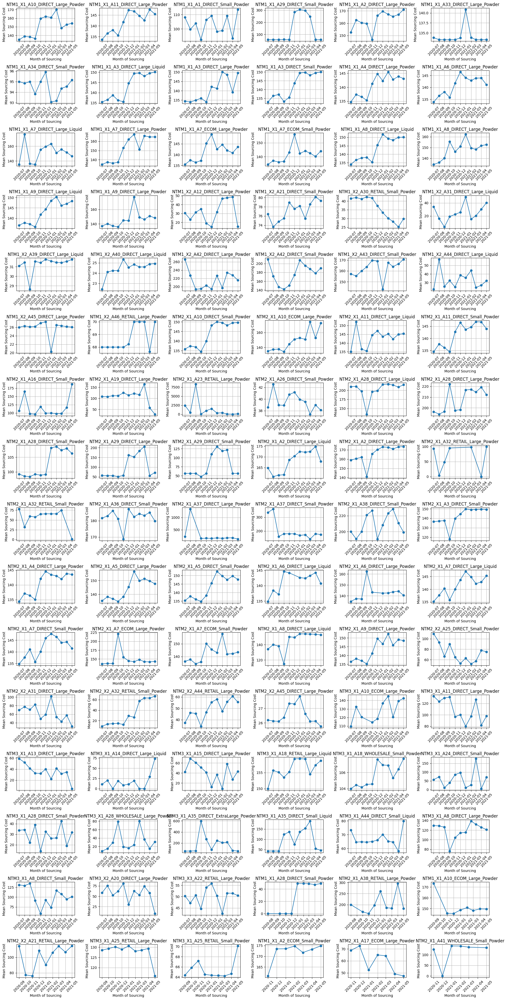

In [7]:
aggregated_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].mean().reset_index()

unique_combinations = aggregated_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))

axes = axes.flatten()

for i, combination in enumerate(unique_combinations):

    subset = aggregated_data[aggregated_data['Product Combination'] == combination]

    axes[i].plot(subset['Month of Sourcing'], subset['Sourcing Cost'], marker='o', linestyle='-')
    axes[i].set_title(f'{combination}')
    axes[i].set_xlabel('Month of Sourcing')
    axes[i].set_ylabel('Mean Sourcing Cost')
    axes[i].grid(True)
    axes[i].tick_params(axis='x', rotation=45)

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()

plt.show()

### Decomposition using additive model

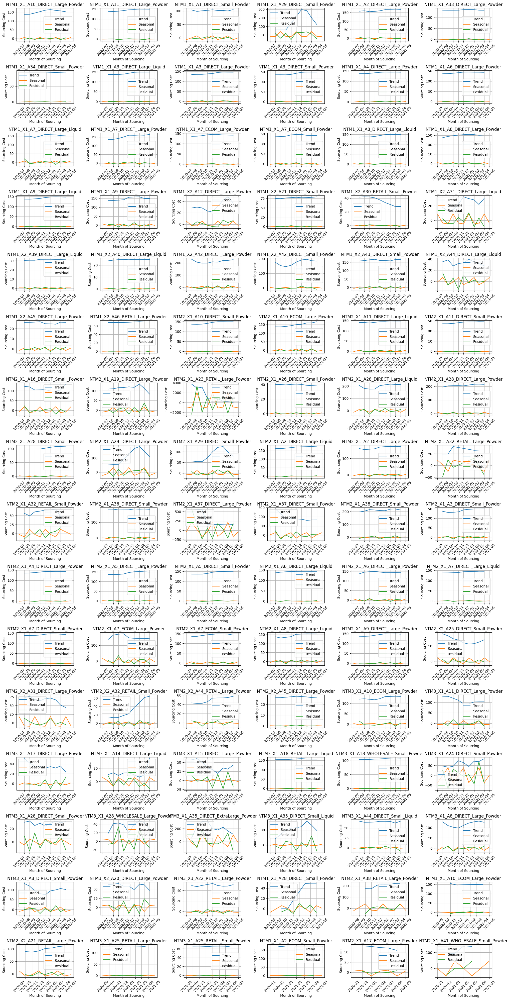

In [8]:

def decompose_time_series_additive(x):
    try:
        decomposition = seasonal_decompose(x, model='additive', period=3)  # Assuming seasonal period is 3 months
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        return trend, seasonal, residual
    except Exception as e:
        print(f"Error occurred: {e}")
        return None, None, None


mean_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].mean().reset_index()


unique_combinations = mean_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = mean_data[mean_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series_additive(subset['Sourcing Cost'])

    if trend is not None and seasonal is not None and residual is not None:

        axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
        axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
        axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
        axes[i].set_title(f'{combination}')
        axes[i].set_xlabel('Month of Sourcing')
        axes[i].set_ylabel('Sourcing Cost')
        axes[i].legend()
        axes[i].grid(True)
        axes[i].tick_params(axis='x', rotation=45)
    else:

        axes[i].text(0.5, 0.5, "Decomposition failed", horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes)
        axes[i].set_title(f'{combination}')
        axes[i].axis('off')

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


### Decomposition using Multiplicative Model

Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values


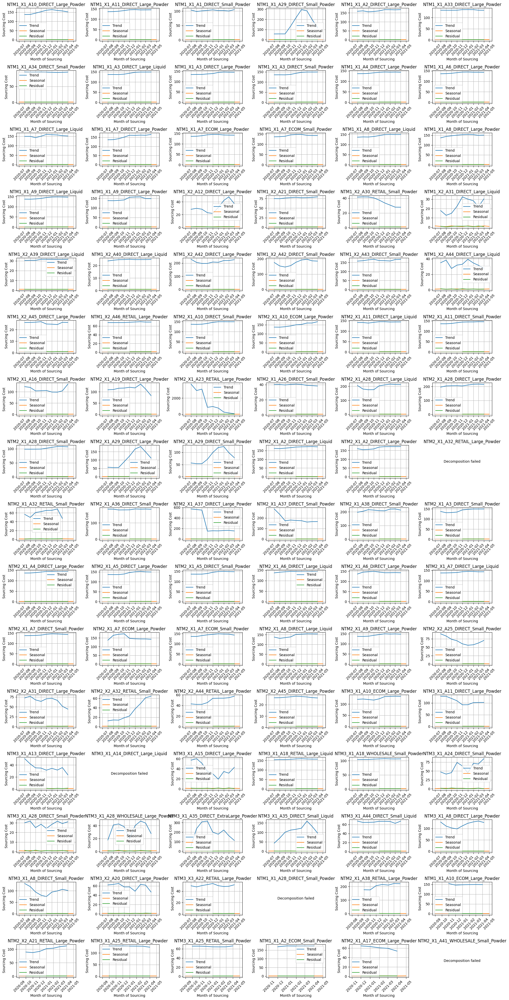

In [9]:

def decompose_time_series_multiplicative(x):
    try:
        decomposition = seasonal_decompose(x, model='multiplicative', period=3)
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        return trend, seasonal, residual
    except Exception as e:
        print(f"Error occurred: {e}")
        return None, None, None


mean_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].mean().reset_index()


unique_combinations = mean_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = mean_data[mean_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series_multiplicative(subset['Sourcing Cost'])

    if trend is not None and seasonal is not None and residual is not None:

        axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
        axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
        axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
        axes[i].set_title(f'{combination}')
        axes[i].set_xlabel('Month of Sourcing')
        axes[i].set_ylabel('Sourcing Cost')
        axes[i].legend()
        axes[i].grid(True)
        axes[i].tick_params(axis='x', rotation=45)
    else:

        axes[i].text(0.5, 0.5, "Decomposition failed", horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes)
        axes[i].set_title(f'{combination}')
        axes[i].axis('off')

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## Visualize time series using minimum aggregation

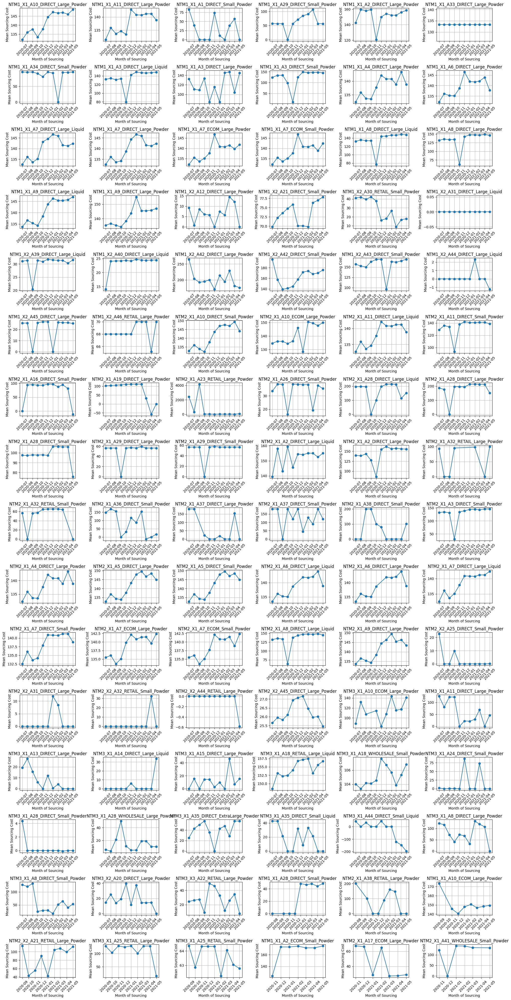

In [10]:
aggregated_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].min().reset_index()

unique_combinations = aggregated_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))

axes = axes.flatten()

for i, combination in enumerate(unique_combinations):

    subset = aggregated_data[aggregated_data['Product Combination'] == combination]

    axes[i].plot(subset['Month of Sourcing'], subset['Sourcing Cost'], marker='o', linestyle='-')
    axes[i].set_title(f'{combination}')
    axes[i].set_xlabel('Month of Sourcing')
    axes[i].set_ylabel('Mean Sourcing Cost')
    axes[i].grid(True)
    axes[i].tick_params(axis='x', rotation=45)

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()

plt.show()

### Decomposition using Additive

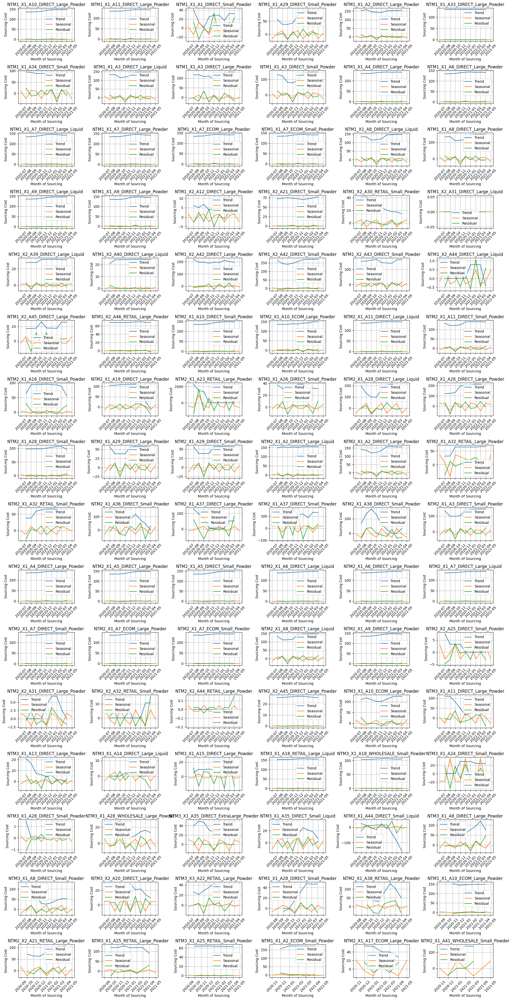

In [11]:

def decompose_time_series_additive(x):
    try:
        decomposition = seasonal_decompose(x, model='additive', period=3)  # Assuming seasonal period is 3 months
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        return trend, seasonal, residual
    except Exception as e:
        print(f"Error occurred: {e}")
        return None, None, None

min_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].min().reset_index()


unique_combinations = min_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = min_data[min_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series_additive(subset['Sourcing Cost'])

    if trend is not None and seasonal is not None and residual is not None:

        axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
        axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
        axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
        axes[i].set_title(f'{combination}')
        axes[i].set_xlabel('Month of Sourcing')
        axes[i].set_ylabel('Sourcing Cost')
        axes[i].legend()
        axes[i].grid(True)
        axes[i].tick_params(axis='x', rotation=45)
    else:

        axes[i].text(0.5, 0.5, "Decomposition failed", horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes)
        axes[i].set_title(f'{combination}')
        axes[i].axis('off')

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


### Decomposition using Multiplicative

Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values

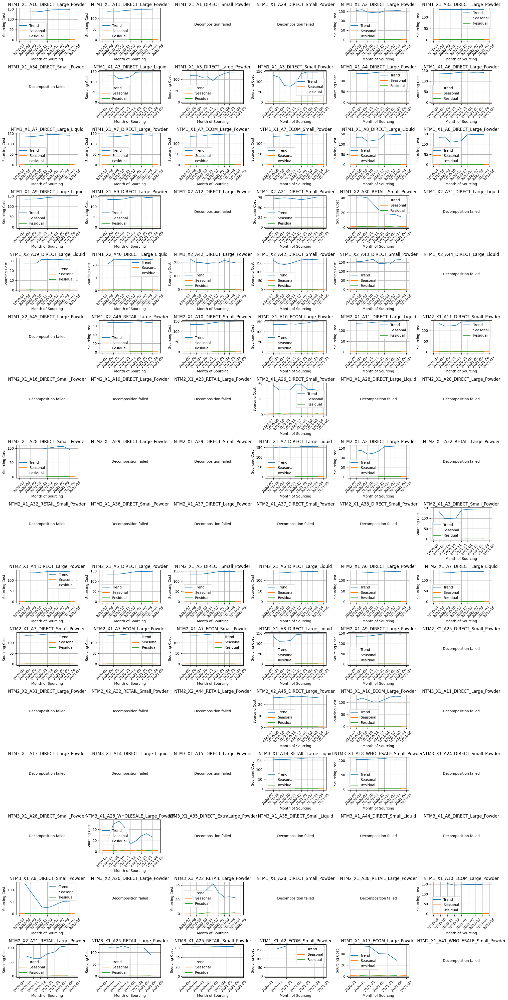

In [12]:

def decompose_time_series_multiplicative(x):
    try:
        decomposition = seasonal_decompose(x, model='multiplicative', period=3)
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        return trend, seasonal, residual
    except Exception as e:
        print(f"Error occurred: {e}")
        return None, None, None


min_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].min().reset_index()


unique_combinations = min_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = min_data[min_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series_multiplicative(subset['Sourcing Cost'])

    if trend is not None and seasonal is not None and residual is not None:

        axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
        axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
        axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
        axes[i].set_title(f'{combination}')
        axes[i].set_xlabel('Month of Sourcing')
        axes[i].set_ylabel('Sourcing Cost')
        axes[i].legend()
        axes[i].grid(True)
        axes[i].tick_params(axis='x', rotation=45)
    else:

        axes[i].text(0.5, 0.5, "Decomposition failed", horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes)
        axes[i].set_title(f'{combination}')
        axes[i].axis('off')

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## Visualize Time series using Maximum Aggregation

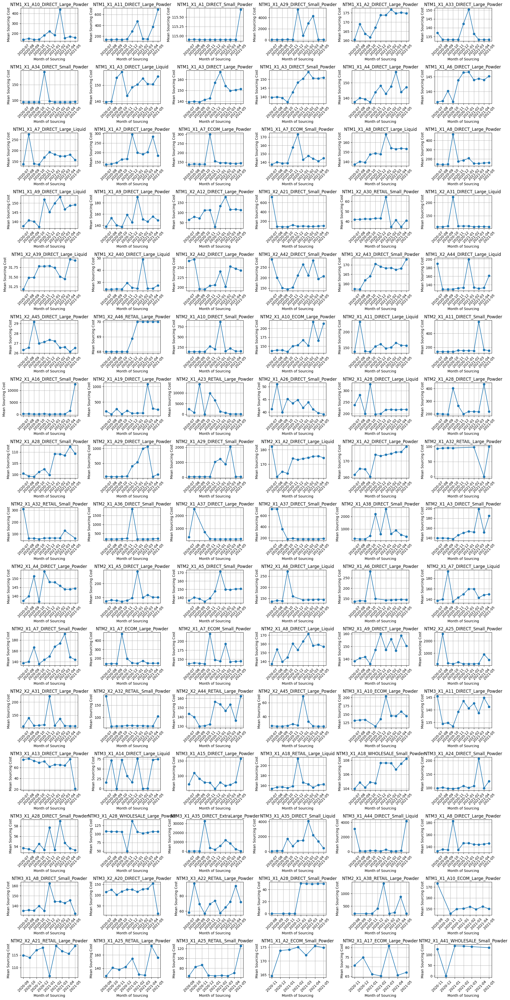

In [13]:
aggregated_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].max().reset_index()

unique_combinations = aggregated_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))

axes = axes.flatten()

for i, combination in enumerate(unique_combinations):

    subset = aggregated_data[aggregated_data['Product Combination'] == combination]

    axes[i].plot(subset['Month of Sourcing'], subset['Sourcing Cost'], marker='o', linestyle='-')
    axes[i].set_title(f'{combination}')
    axes[i].set_xlabel('Month of Sourcing')
    axes[i].set_ylabel('Mean Sourcing Cost')
    axes[i].grid(True)
    axes[i].tick_params(axis='x', rotation=45)

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()

plt.show()

### Additive Trend

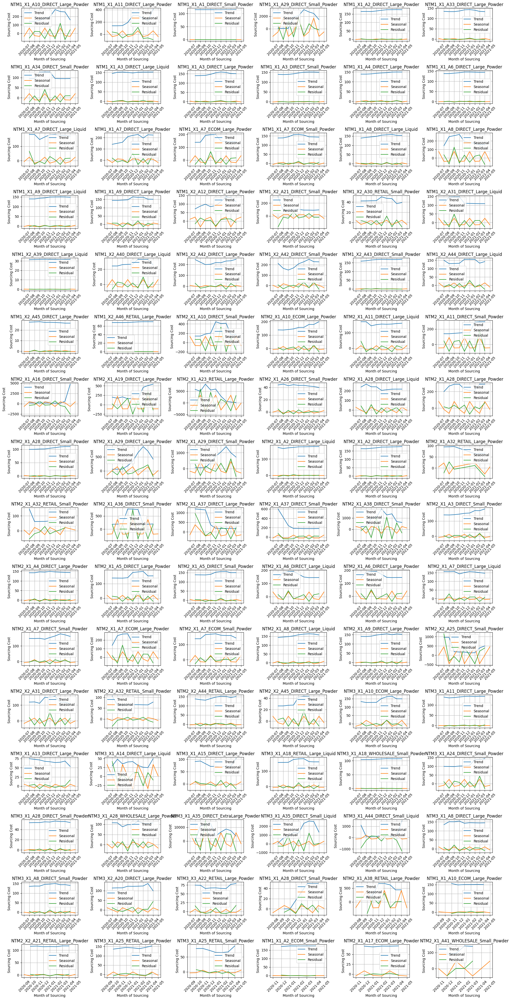

In [14]:

def decompose_time_series_additive(x):
    try:
        decomposition = seasonal_decompose(x, model='additive', period=3)  # Assuming seasonal period is 3 months
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        return trend, seasonal, residual
    except Exception as e:
        print(f"Error occurred: {e}")
        return None, None, None


max_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].max().reset_index()


unique_combinations = max_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = max_data[max_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series_additive(subset['Sourcing Cost'])

    if trend is not None and seasonal is not None and residual is not None:

        axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
        axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
        axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
        axes[i].set_title(f'{combination}')
        axes[i].set_xlabel('Month of Sourcing')
        axes[i].set_ylabel('Sourcing Cost')
        axes[i].legend()
        axes[i].grid(True)
        axes[i].tick_params(axis='x', rotation=45)
    else:

        axes[i].text(0.5, 0.5, "Decomposition failed", horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes)
        axes[i].set_title(f'{combination}')
        axes[i].axis('off')

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


### Multiplicative Trend

Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values


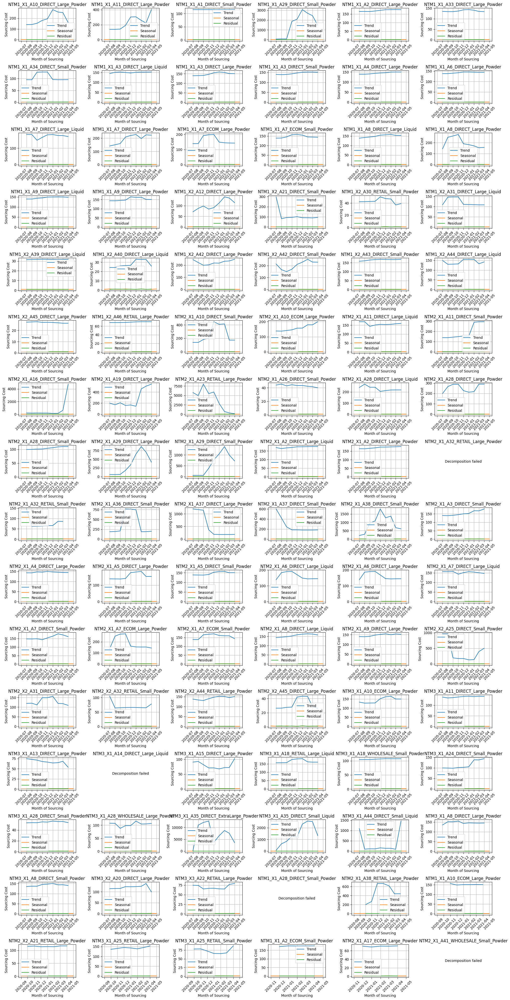

In [15]:

def decompose_time_series_multiplicative(x):
    try:
        decomposition = seasonal_decompose(x, model='multiplicative', period=3)  # Assuming seasonal period is 3 months
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        return trend, seasonal, residual
    except Exception as e:
        print(f"Error occurred: {e}")
        return None, None, None


max_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].max().reset_index()


unique_combinations = max_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = max_data[max_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series_multiplicative(subset['Sourcing Cost'])

    if trend is not None and seasonal is not None and residual is not None:

        axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
        axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
        axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
        axes[i].set_title(f'{combination}')
        axes[i].set_xlabel('Month of Sourcing')
        axes[i].set_ylabel('Sourcing Cost')
        axes[i].legend()
        axes[i].grid(True)
        axes[i].tick_params(axis='x', rotation=45)
    else:

        axes[i].text(0.5, 0.5, "Decomposition failed", horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes)
        axes[i].set_title(f'{combination}')
        axes[i].axis('off')

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## Visualize Time Series using median aggregation

Median is a great option to consider as it is the 50th Percentile. As a result the extreme values are eliminated and the 50th percentile value is considered.

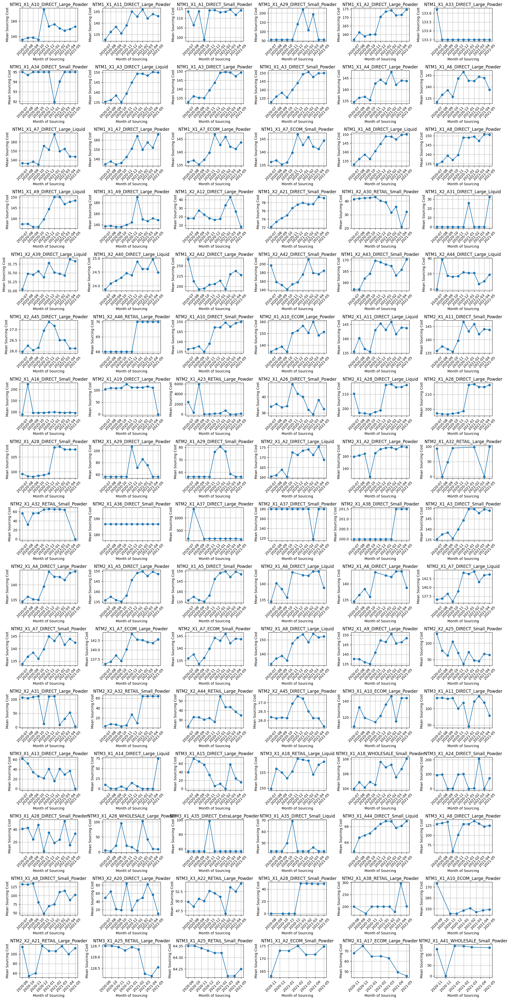

In [16]:
aggregated_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].median().reset_index()

unique_combinations = aggregated_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))

axes = axes.flatten()

for i, combination in enumerate(unique_combinations):

    subset = aggregated_data[aggregated_data['Product Combination'] == combination]

    axes[i].plot(subset['Month of Sourcing'], subset['Sourcing Cost'], marker='o', linestyle='-')
    axes[i].set_title(f'{combination}')
    axes[i].set_xlabel('Month of Sourcing')
    axes[i].set_ylabel('Mean Sourcing Cost')
    axes[i].grid(True)
    axes[i].tick_params(axis='x', rotation=45)

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()

plt.show()

### Additive Trend Visualization

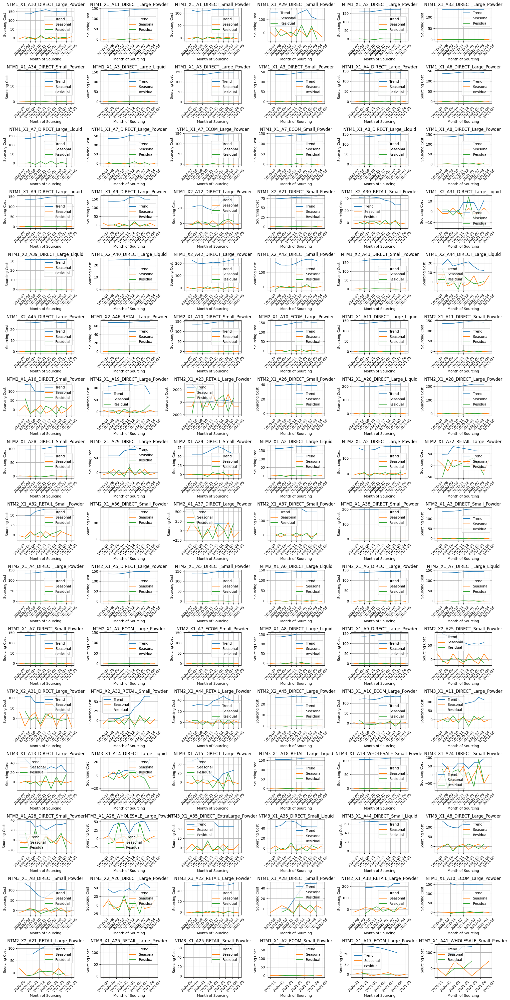

In [17]:
from statsmodels.tsa.seasonal import seasonal_decompose


def decompose_time_series(x):
    decomposition = seasonal_decompose(x, model='additive', period=3)
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    return trend, seasonal, residual


def calculate_median(x):
    return np.median(x)


median_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].apply(calculate_median).reset_index()


unique_combinations = median_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = median_data[median_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series(subset['Sourcing Cost'])

    if trend is not None and seasonal is not None and residual is not None:

        axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
        axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
        axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
        axes[i].set_title(f'{combination}')
        axes[i].set_xlabel('Month of Sourcing')
        axes[i].set_ylabel('Sourcing Cost')
        axes[i].legend()
        axes[i].grid(True)
        axes[i].tick_params(axis='x', rotation=45)
    else:

        axes[i].text(0.5, 0.5, "Decomposition failed", horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes)
        axes[i].set_title(f'{combination}')
        axes[i].axis('off')

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


### Multiplicative trend visualization

Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values


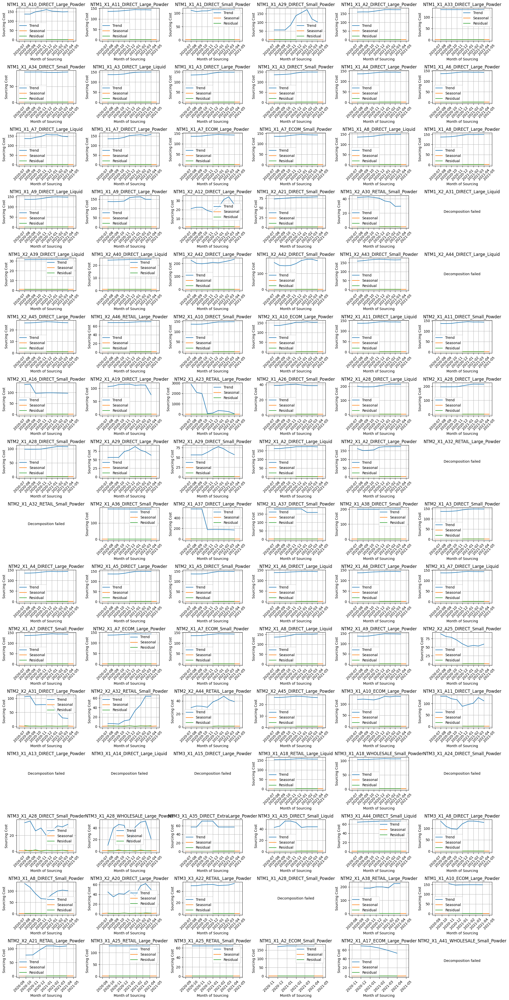

In [18]:

def decompose_time_series(x):
    try:
        decomposition = seasonal_decompose(x, model='multiplicative', period=3)
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        return trend, seasonal, residual
    except Exception as e:
        print(f"Error occurred: {e}")
        return None, None, None


median_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].apply(np.median).reset_index()


unique_combinations = median_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = median_data[median_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series(subset['Sourcing Cost'])

    if trend is not None and seasonal is not None and residual is not None:

        axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
        axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
        axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
        axes[i].set_title(f'{combination}')
        axes[i].set_xlabel('Month of Sourcing')
        axes[i].set_ylabel('Sourcing Cost')
        axes[i].legend()
        axes[i].grid(True)
        axes[i].tick_params(axis='x', rotation=45)
    else:

        axes[i].text(0.5, 0.5, "Decomposition failed", horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes)
        axes[i].set_title(f'{combination}')
        axes[i].axis('off')

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## Visualize data using trimmed mean

Outlier analysis for all 96 unique items and also for each month (96*11 iterations) required heavy computational power and time, thus trimmed mean is chosen. It will automatically exclude the extreme values.

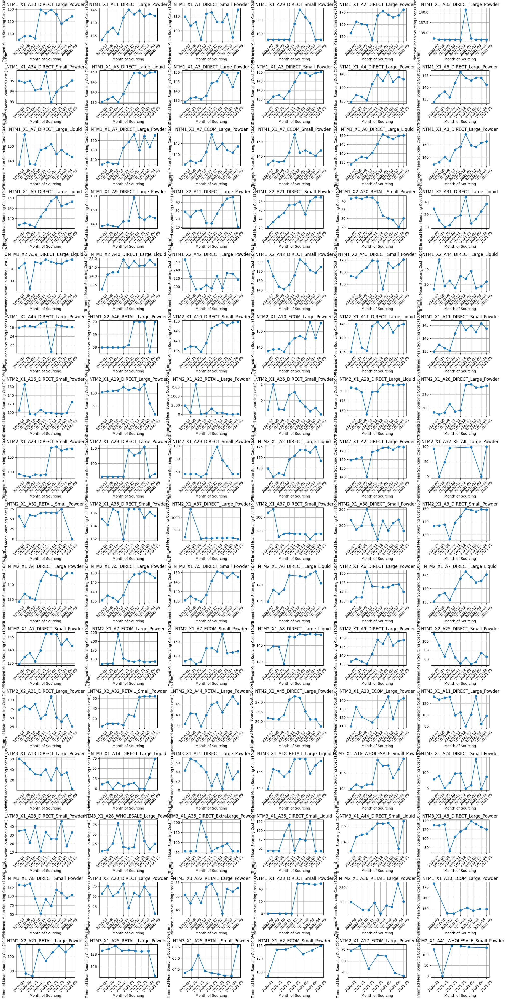

In [19]:

def calculate_trimmed_mean(x, trim_percent):
    n = len(x)
    trim_count = int(n * trim_percent)
    sorted_values = np.sort(x)
    trimmed_values = sorted_values[trim_count:-trim_count]
    if len(trimmed_values) == 0:
        return np.mean(sorted_values)  # Return pure mean if no values remain after trimming
    else:
        return np.mean(trimmed_values)


trim_percent = 0.1


trimmed_mean_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].apply(lambda x: calculate_trimmed_mean(x, trim_percent)).reset_index()


unique_combinations = trimmed_mean_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = trimmed_mean_data[trimmed_mean_data['Product Combination'] == combination]
    axes[i].plot(subset['Month of Sourcing'], subset['Sourcing Cost'], marker='o', linestyle='-')
    axes[i].set_title(f'{combination}')
    axes[i].set_xlabel('Month of Sourcing')
    axes[i].set_ylabel(f'Trimmed Mean Sourcing Cost ({trim_percent*100}% trim)')
    axes[i].grid(True)
    axes[i].tick_params(axis='x', rotation=45)

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


### Additive Trend

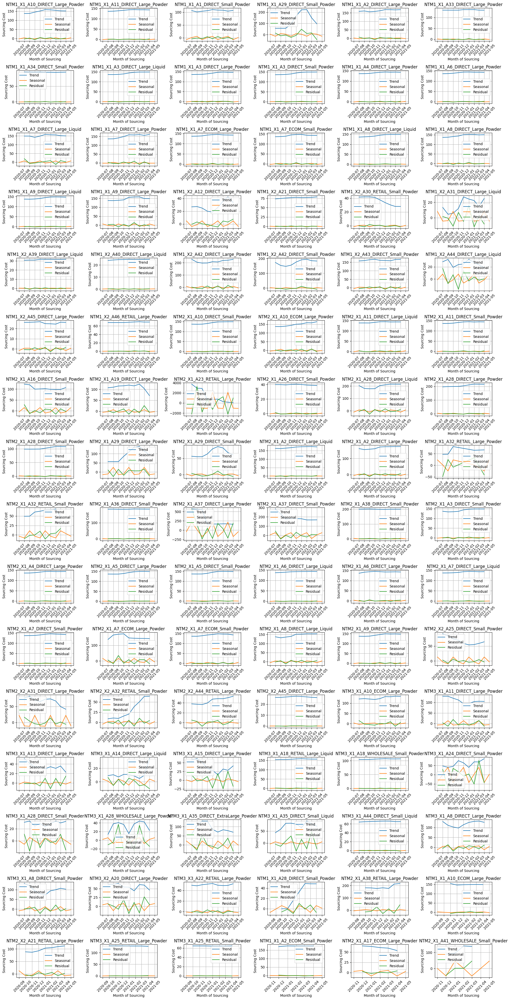

In [20]:
from statsmodels.tsa.seasonal import seasonal_decompose


def decompose_time_series(x):
    decomposition = seasonal_decompose(x, model='additive', period=3)
    trend = decomposition.trend
    seasonal = decomposition.seasonal
    residual = decomposition.resid
    return trend, seasonal, residual


trim_percent = 0.1


trimmed_mean_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].apply(lambda x: calculate_trimmed_mean(x, trim_percent)).reset_index()


unique_combinations = trimmed_mean_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = trimmed_mean_data[trimmed_mean_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series(subset['Sourcing Cost'])


    axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
    axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
    axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
    axes[i].set_title(f'{combination}')
    axes[i].set_xlabel('Month of Sourcing')
    axes[i].set_ylabel('Sourcing Cost')
    axes[i].legend()
    axes[i].grid(True)
    axes[i].tick_params(axis='x', rotation=45)

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


### Multiplicative Trend

Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values
Error occurred: Multiplicative seasonality is not appropriate for zero and negative values


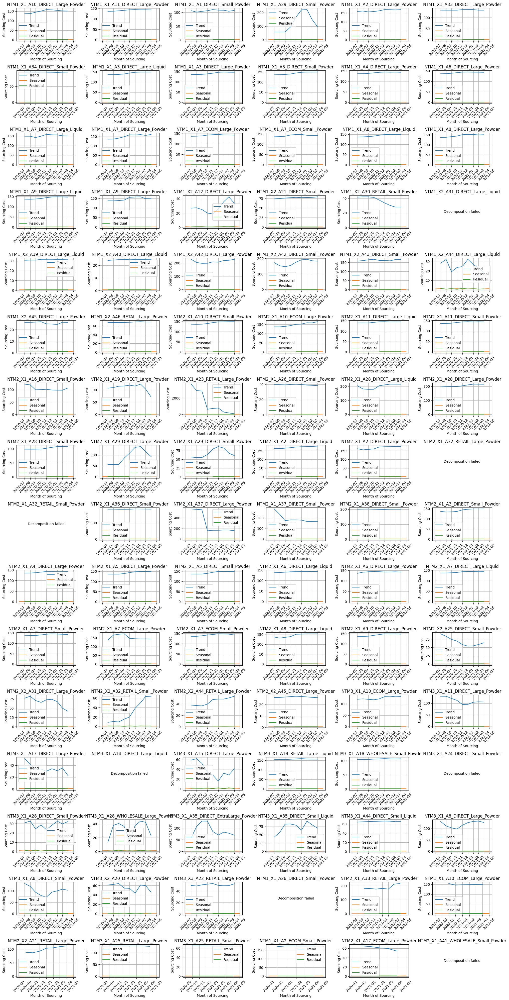

In [21]:

def decompose_time_series(x):
    try:
        decomposition = seasonal_decompose(x, model='multiplicative', period=3)  # Assuming seasonal period is 12 months
        trend = decomposition.trend
        seasonal = decomposition.seasonal
        residual = decomposition.resid
        return trend, seasonal, residual
    except Exception as e:
        print(f"Error occurred: {e}")
        return None, None, None


trim_percent = 0.1


trimmed_mean_data = train.groupby(['Month of Sourcing', 'Product Combination'])['Sourcing Cost'].apply(lambda x: calculate_trimmed_mean(x, trim_percent)).reset_index()

unique_combinations = trimmed_mean_data['Product Combination'].unique()

fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))
axes = axes.flatten()

for i, combination in enumerate(unique_combinations):
    subset = trimmed_mean_data[trimmed_mean_data['Product Combination'] == combination]


    trend, seasonal, residual = decompose_time_series(subset['Sourcing Cost'])

    if trend is not None and seasonal is not None and residual is not None:
        # Plot the components
        axes[i].plot(subset['Month of Sourcing'], trend, label='Trend')
        axes[i].plot(subset['Month of Sourcing'], seasonal, label='Seasonal')
        axes[i].plot(subset['Month of Sourcing'], residual, label='Residual')
        axes[i].set_title(f'{combination}')
        axes[i].set_xlabel('Month of Sourcing')
        axes[i].set_ylabel('Sourcing Cost')
        axes[i].legend()
        axes[i].grid(True)
        axes[i].tick_params(axis='x', rotation=45)
    else:
        # Plot error message if decomposition failed
        axes[i].text(0.5, 0.5, "Decomposition failed", horizontalalignment='center', verticalalignment='center', transform=axes[i].transAxes)
        axes[i].set_title(f'{combination}')
        axes[i].axis('off')

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


# Load Testing dataset

In [22]:
import pandas as pd


test = pd.read_csv("testing.csv")


print(test.head())

test = test.dropna()

print(test.shape)


null_counts = test.isnull().sum()


print("Number of null values in each column:")
print(null_counts)

  ProductType Manufacturer Area Code Sourcing Channel Product Size  \
0        NTM1           X1        A1           DIRECT        Small   
1        NTM1           X1       A10           DIRECT        Large   
2        NTM1           X1       A10             ECOM        Large   
3        NTM1           X1       A11           DIRECT        Large   
4        NTM1           X1        A2           DIRECT        Large   

  Product Type Month of Sourcing  Sourcing Cost  
0       Powder            Jun-21         103.68  
1       Powder            Jun-21         155.75  
2       Powder            Jun-21         143.02  
3       Powder            Jun-21         139.39  
4       Powder            Jun-21         169.42  
(96, 8)
Number of null values in each column:
ProductType          0
Manufacturer         0
Area Code            0
Sourcing Channel     0
Product Size         0
Product Type         0
Month of Sourcing    0
Sourcing Cost        0
dtype: int64


In [23]:

test['Product Combination'] = test[['ProductType', 'Manufacturer', 'Area Code', 'Sourcing Channel', 'Product Size', 'Product Type']].apply(lambda x: '_'.join(str(e) for e in x), axis=1)


print(test.head())

  ProductType Manufacturer Area Code Sourcing Channel Product Size  \
0        NTM1           X1        A1           DIRECT        Small   
1        NTM1           X1       A10           DIRECT        Large   
2        NTM1           X1       A10             ECOM        Large   
3        NTM1           X1       A11           DIRECT        Large   
4        NTM1           X1        A2           DIRECT        Large   

  Product Type Month of Sourcing  Sourcing Cost  \
0       Powder            Jun-21         103.68   
1       Powder            Jun-21         155.75   
2       Powder            Jun-21         143.02   
3       Powder            Jun-21         139.39   
4       Powder            Jun-21         169.42   

               Product Combination  
0   NTM1_X1_A1_DIRECT_Small_Powder  
1  NTM1_X1_A10_DIRECT_Large_Powder  
2    NTM1_X1_A10_ECOM_Large_Powder  
3  NTM1_X1_A11_DIRECT_Large_Powder  
4   NTM1_X1_A2_DIRECT_Large_Powder  


<ipython-input-23-eccc945f5ecd>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test['Product Combination'] = test[['ProductType', 'Manufacturer', 'Area Code', 'Sourcing Channel', 'Product Size', 'Product Type']].apply(lambda x: '_'.join(str(e) for e in x), axis=1)


In [24]:

merged = train[['Product Combination']].merge(test[['Product Combination']], how='inner', on='Product Combination')


num_same_combinations = merged['Product Combination'].nunique()

print("Number of unique Product Combinations present in both train and test datasets:", num_same_combinations)


Number of unique Product Combinations present in both train and test datasets: 96


Thus Product description in train and test matches for all unique products.

# Checking Stationarity

In [25]:
from statsmodels.tsa.stattools import adfuller

unique_items = train['Product Combination'].unique()

In [26]:
non_stationary_mean = []

for combination in unique_combinations:
    subset = train[train['Product Combination'] == combination]
    mean_values = subset['Sourcing Cost'].mean()


    if mean_values.std() != 0:
        result = adfuller(mean_values)
        if result[1] > 0.05:
            non_stationary_mean.append(combination)

print("Non-stationary time series for Mean Aggregation:", non_stationary_mean)


Non-stationary time series for Mean Aggregation: []


In [27]:
non_stationary_min = []

for combination in unique_combinations:
    subset = train[train['Product Combination'] == combination]
    min_values = subset['Sourcing Cost'].min()


    if min_values.std() != 0:
        result = adfuller(min_values)
        if result[1] > 0.05:
            non_stationary_min.append(combination)

print("Non-stationary time series for Minimum Aggregation:", non_stationary_min)


Non-stationary time series for Minimum Aggregation: []


In [28]:
non_stationary_max = []

for combination in unique_combinations:
    subset = train[train['Product Combination'] == combination]
    max_values = subset['Sourcing Cost'].max()


    if max_values.std() != 0:
        result = adfuller(max_values)
        if result[1] > 0.05:
            non_stationary_max.append(combination)

print("Non-stationary time series for Maximum Aggregation:", non_stationary_max)


Non-stationary time series for Maximum Aggregation: []


In [29]:
non_stationary_median = []

for combination in unique_combinations:
    subset = train[train['Product Combination'] == combination]
    median_values = subset['Sourcing Cost'].median()


    if median_values.std() != 0:
        result = adfuller(median_values)
        if result[1] > 0.05:
            non_stationary_median.append(combination)

print("Non-stationary time series for Median Aggregation:", non_stationary_median)


Non-stationary time series for Median Aggregation: []


In [30]:
non_stationary_trimmed_mean = []

for combination in unique_combinations:
    subset = train[train['Product Combination'] == combination]
    trimmed_mean_values = calculate_trimmed_mean(subset['Sourcing Cost'], trim_percent=0.1)


    if trimmed_mean_values.std() != 0:
        result = adfuller(trimmed_mean_values)
        if result[1] > 0.05:
            non_stationary_trimmed_mean.append(combination)

print("Non-stationary time series for Trimmed Mean Aggregation:", non_stationary_trimmed_mean)


Non-stationary time series for Trimmed Mean Aggregation: []


Time series for all items are stationary. Thus no need for further noise removal

# PACF Plots

## Mean Aggregate

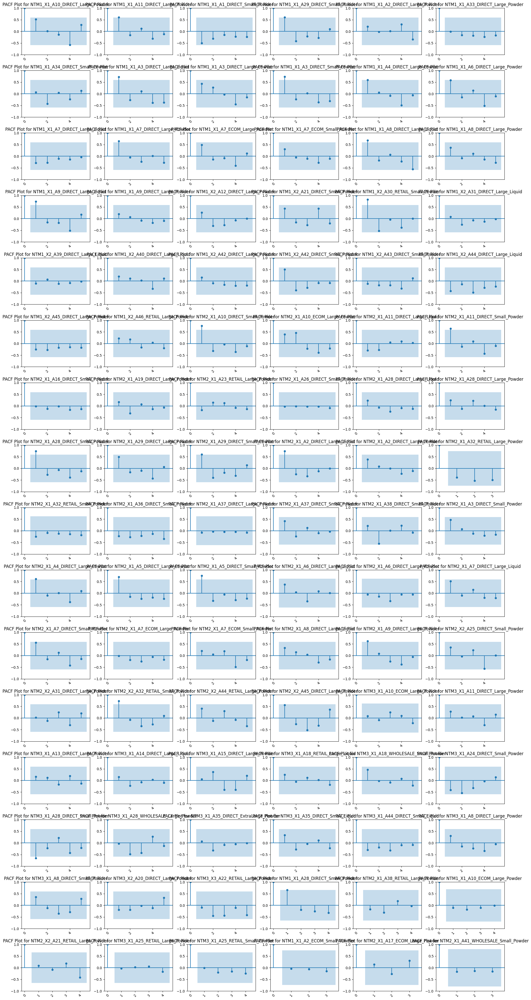

In [31]:
from statsmodels.graphics.tsaplots import plot_pacf
import matplotlib.pyplot as plt


def plot_pacf_series(series, ax, title):
    plot_pacf(series, ax=ax, title=title)


fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))


axes = axes.flatten()


for i, combination in enumerate(unique_combinations):
    subset = train[train['Product Combination'] == combination]
    series = subset.groupby('Month of Sourcing')['Sourcing Cost'].agg('mean')
    plot_pacf_series(series, ax=axes[i], title=f'PACF Plot for {combination}')
    axes[i].tick_params(axis='x', rotation=45)


for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## Min Aggregate

/usr/local/lib/python3.10/dist-packages/statsmodels/regression/linear_model.py:1491: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


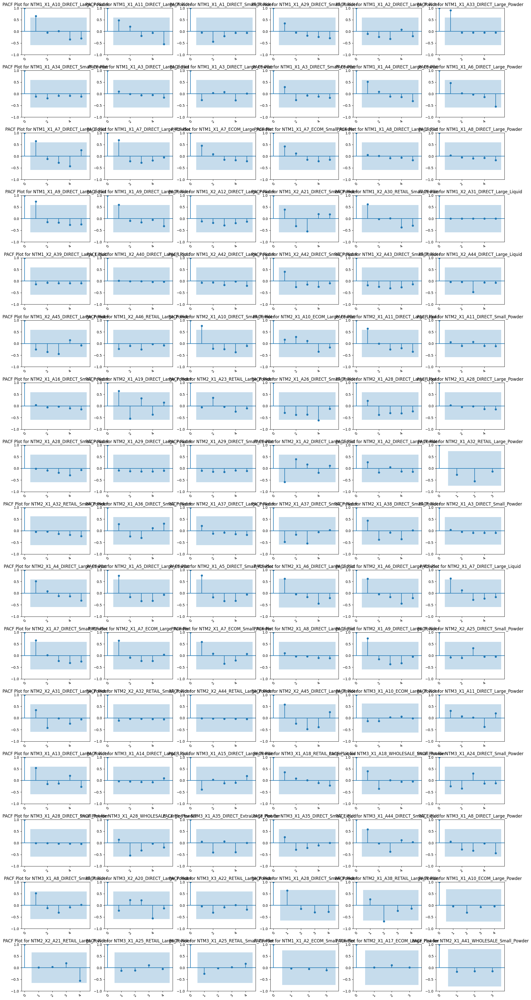

In [32]:
from statsmodels.graphics.tsaplots import plot_pacf
import matplotlib.pyplot as plt


def plot_pacf_series(series, ax, title):
    plot_pacf(series, ax=ax, title=title)


fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))


axes = axes.flatten()


for i, combination in enumerate(unique_combinations):
    subset = train[train['Product Combination'] == combination]
    series = subset.groupby('Month of Sourcing')['Sourcing Cost'].agg('min')  # Using the minimum aggregation function
    plot_pacf_series(series, ax=axes[i], title=f'PACF Plot for {combination}')
    axes[i].tick_params(axis='x', rotation=45)


for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## Max Aggregate

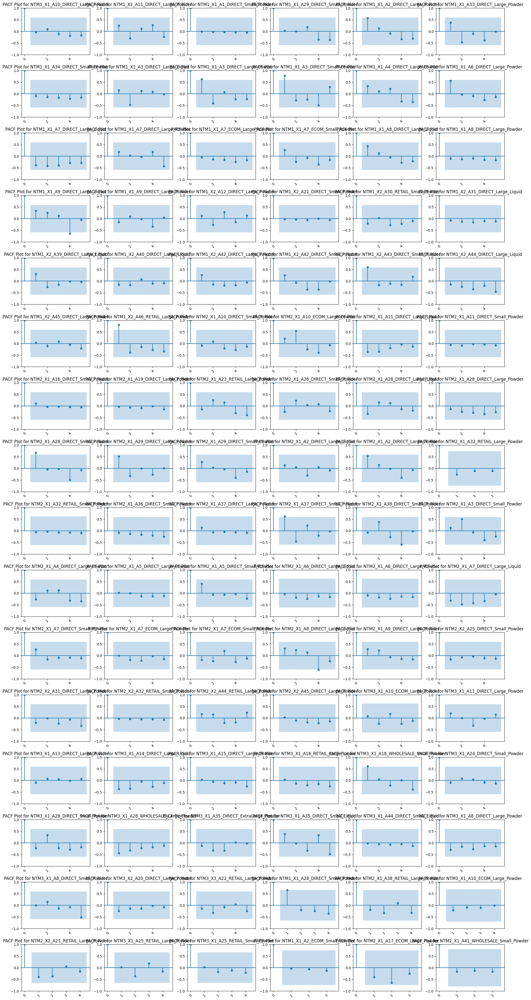

In [33]:
from statsmodels.graphics.tsaplots import plot_pacf
import matplotlib.pyplot as plt


def plot_pacf_series(series, ax, title):
    plot_pacf(series, ax=ax, title=title)


fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))


axes = axes.flatten()


for i, combination in enumerate(unique_combinations):
    subset = train[train['Product Combination'] == combination]
    series = subset.groupby('Month of Sourcing')['Sourcing Cost'].agg('max')  # Using the maximum aggregation function
    plot_pacf_series(series, ax=axes[i], title=f'PACF Plot for {combination}')
    axes[i].tick_params(axis='x', rotation=45)


for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


## Median Aggregate

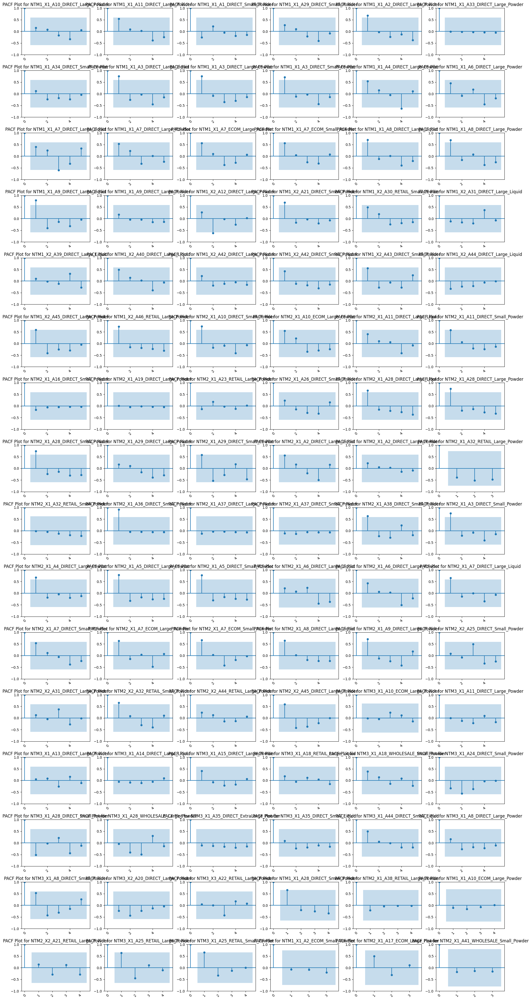

In [34]:
from statsmodels.graphics.tsaplots import plot_pacf
import matplotlib.pyplot as plt


def plot_pacf_series(series, ax, title):
    plot_pacf(series, ax=ax, title=title)


fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))


axes = axes.flatten()


for i, combination in enumerate(unique_combinations):
    subset = train[train['Product Combination'] == combination]
    series = subset.groupby('Month of Sourcing')['Sourcing Cost'].agg('median')  # Using the median aggregation function
    plot_pacf_series(series, ax=axes[i], title=f'PACF Plot for {combination}')
    axes[i].tick_params(axis='x', rotation=45)


for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


##Trimmed Mean Aggregate

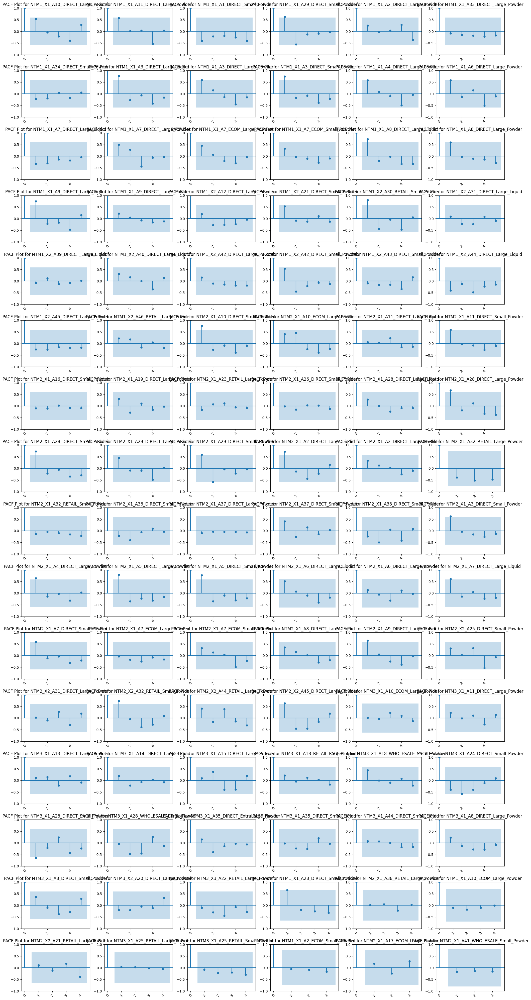

In [35]:
from statsmodels.graphics.tsaplots import plot_pacf
import matplotlib.pyplot as plt


def plot_pacf_series(series, ax, title):
    plot_pacf(series, ax=ax, title=title)


fig, axes = plt.subplots(nrows=16, ncols=6, figsize=(20, 40))


axes = axes.flatten()


for i, combination in enumerate(unique_combinations):
    subset = train[train['Product Combination'] == combination]
    series = subset.groupby('Month of Sourcing')['Sourcing Cost'].apply(lambda x: calculate_trimmed_mean(x, trim_percent))  # Using the trimmed mean aggregation function
    plot_pacf_series(series, ax=axes[i], title=f'PACF Plot for {combination}')
    axes[i].tick_params(axis='x', rotation=45)


for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


# ARIMA Forecasting

In [36]:
from statsmodels.tsa.arima.model import ARIMA

def fit_arima(series):
    model = ARIMA(series, order=(5,1,0))  # ARIMA model with order (5,1,0)
    model_fit = model.fit()
    return model_fit

In [37]:
import warnings
warnings.filterwarnings("ignore")

from statsmodels.tsa.arima.model import ARIMA

from sklearn.metrics import mean_squared_error

def fit_arima(series):
    model = ARIMA(series, order=(1,1,0))
    model_fit = model.fit()
    return model_fit


item_errors = {}


for combination in unique_combinations:

    subset_train = train[train['Product Combination'] == combination]
    series_train = subset_train.groupby('Month of Sourcing')['Sourcing Cost'].mean()


    if len(series_train) >= 5:
        try:

            model_fit = fit_arima(series_train)


            forecast_value = model_fit.forecast(steps=1)[0]


            actual_value = test[(test['Product Combination'] == combination) & (test['Month of Sourcing'] == 'Jun-21')]['Sourcing Cost'].values[0]


            error = abs(forecast_value - actual_value)


            item_errors[combination] = error


            print(f"Combination: {combination}, Actual: {actual_value}, Forecast: {forecast_value}, Error: {error}")
        except:
            print(f"Failed to fit ARIMA for Combination: {combination}")
    else:
        print(f"Not enough data points for Combination: {combination}")


mse = mean_squared_error(list(item_errors.values()), [0] * len(item_errors))
print(f"MSE: {mse}")



mean_item_error=item_errors

Combination: NTM1_X1_A10_DIRECT_Large_Powder, Actual: 155.75, Forecast: 153.82308174549362, Error: 1.9269182545063757
Combination: NTM1_X1_A11_DIRECT_Large_Powder, Actual: 139.39, Forecast: 145.4436428233101, Error: 6.053642823310128
Combination: NTM1_X1_A1_DIRECT_Small_Powder, Actual: 103.68, Forecast: 98.64608970266386, Error: 5.033910297336149
Combination: NTM1_X1_A29_DIRECT_Small_Powder, Actual: 56.52, Forecast: 56.51990654205608, Error: 9.345794392601192e-05
Combination: NTM1_X1_A2_DIRECT_Large_Powder, Actual: 169.42, Forecast: 169.79682933687994, Error: 0.37682933687995046
Combination: NTM1_X1_A33_DIRECT_Large_Powder, Actual: 133.83, Forecast: 133.3, Error: 0.5300000000000011
Combination: NTM1_X1_A34_DIRECT_Small_Powder, Actual: 95.0, Forecast: 95.029461109931, Error: 0.029461109931006035
Combination: NTM1_X1_A3_DIRECT_Large_Liquid, Actual: 125.51, Forecast: 150.29216304682558, Error: 24.782163046825573
Combination: NTM1_X1_A3_DIRECT_Large_Powder, Actual: 157.27, Forecast: 144.73

In [38]:
import warnings
warnings.filterwarnings("ignore")

from statsmodels.tsa.arima.model import ARIMA

from sklearn.metrics import mean_squared_error

def fit_arima(series):
    model = ARIMA(series, order=(1,1,0))
    model_fit = model.fit()
    return model_fit


item_errors = {}


for combination in unique_combinations:

    subset_train = train[train['Product Combination'] == combination]
    series_train = subset_train.groupby('Month of Sourcing')['Sourcing Cost'].min()


    if len(series_train) >= 5:
        try:

            model_fit = fit_arima(series_train)


            forecast_value = model_fit.forecast(steps=1)[0]


            actual_value = test[(test['Product Combination'] == combination) & (test['Month of Sourcing'] == 'Jun-21')]['Sourcing Cost'].values[0]


            error = abs(forecast_value - actual_value)


            item_errors[combination] = error


            print(f"Combination: {combination}, Actual: {actual_value}, Forecast: {forecast_value}, Error: {error}")
        except Exception as e:
            print(f"Failed to fit ARIMA for Combination: {combination}. Exception: {str(e)}")
    else:
        print(f"Not enough data points for Combination: {combination}")


mse = mean_squared_error(list(item_errors.values()), [0] * len(item_errors))
print(f"MSE: {mse}")



min_item_error=item_errors

Combination: NTM1_X1_A10_DIRECT_Large_Powder, Actual: 155.75, Forecast: 149.16278013461135, Error: 6.587219865388647
Combination: NTM1_X1_A11_DIRECT_Large_Powder, Actual: 139.39, Forecast: 139.77030415542743, Error: 0.3803041554274387
Combination: NTM1_X1_A1_DIRECT_Small_Powder, Actual: 103.68, Forecast: 11.766091590587278, Error: 91.91390840941273
Combination: NTM1_X1_A29_DIRECT_Small_Powder, Actual: 56.52, Forecast: 56.50999999999999, Error: 0.010000000000012221
Combination: NTM1_X1_A2_DIRECT_Large_Powder, Actual: 169.42, Forecast: 157.4654596228867, Error: 11.95454037711329
Combination: NTM1_X1_A33_DIRECT_Large_Powder, Actual: 133.83, Forecast: 133.3, Error: 0.5300000000000011
Combination: NTM1_X1_A34_DIRECT_Small_Powder, Actual: 95.0, Forecast: 94.54810807735822, Error: 0.4518919226417779
Combination: NTM1_X1_A3_DIRECT_Large_Liquid, Actual: 125.51, Forecast: 148.03723417599784, Error: 22.527234175997833
Combination: NTM1_X1_A3_DIRECT_Large_Powder, Actual: 157.27, Forecast: 119.5947

In [39]:
import warnings
warnings.filterwarnings("ignore")

from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error

def fit_arima(series):
    model = ARIMA(series, order=(2,1,0))
    model_fit = model.fit()
    return model_fit


item_errors = {}


for combination in unique_combinations:

    subset_train = train[train['Product Combination'] == combination]
    series_train = subset_train.groupby('Month of Sourcing')['Sourcing Cost'].max()


    if len(series_train) >= 1:
        try:

            model = ARIMA(series_train, order=(5,1,0))
            model_fit = model.fit()


            forecast_value = model_fit.forecast(steps=1)[0]


            actual_value = test[(test['Product Combination'] == combination) & (test['Month of Sourcing'] == 'Jun-21')]['Sourcing Cost'].values[0]


            error = abs(forecast_value - actual_value)


            item_errors[combination] = error


            print(f"Combination: {combination}, Actual: {actual_value}, Forecast: {forecast_value}, Error: {error}")
        except Exception as e:
            print(f"Failed to fit ARIMA for Combination: {combination}. Exception: {str(e)}")
    else:
        print(f"Not enough data points for Combination: {combination}")


mse = mean_squared_error(list(item_errors.values()), [0] * len(item_errors))
print(f"MSE: {mse}")


max_item_error=item_errors

Combination: NTM1_X1_A10_DIRECT_Large_Powder, Actual: 155.75, Forecast: 157.9199676039226, Error: 2.1699676039226006
Failed to fit ARIMA for Combination: NTM1_X1_A11_DIRECT_Large_Powder. Exception: LU decomposition error.
Combination: NTM1_X1_A1_DIRECT_Small_Powder, Actual: 103.68, Forecast: 115.69876951272842, Error: 12.018769512728412
Combination: NTM1_X1_A29_DIRECT_Small_Powder, Actual: 56.52, Forecast: 56.52182428615559, Error: 0.00182428615558905
Combination: NTM1_X1_A2_DIRECT_Large_Powder, Actual: 169.42, Forecast: 175.69903684227998, Error: 6.279036842279993
Combination: NTM1_X1_A33_DIRECT_Large_Powder, Actual: 133.83, Forecast: 133.30000264916345, Error: 0.5299973508365667
Combination: NTM1_X1_A34_DIRECT_Small_Powder, Actual: 95.0, Forecast: 95.71223532001774, Error: 0.71223532001774
Combination: NTM1_X1_A3_DIRECT_Large_Liquid, Actual: 125.51, Forecast: 154.08789397361448, Error: 28.57789397361448
Combination: NTM1_X1_A3_DIRECT_Large_Powder, Actual: 157.27, Forecast: 151.350002

In [40]:
import warnings
warnings.filterwarnings("ignore")

from statsmodels.tsa.arima.model import ARIMA

from sklearn.metrics import mean_squared_error

def fit_arima(series):
    model = ARIMA(series, order=(1,1,0))
    model_fit = model.fit()
    return model_fit


item_errors = {}

for combination in unique_combinations:

    subset_train = train[train['Product Combination'] == combination]
    series_train = subset_train.groupby('Month of Sourcing')['Sourcing Cost'].median()


    if len(series_train) >= 1:
        try:

            model_fit = fit_arima(series_train)


            forecast_value = model_fit.forecast(steps=1)[0]


            actual_value = test[(test['Product Combination'] == combination) & (test['Month of Sourcing'] == 'Jun-21')]['Sourcing Cost'].values[0]


            error = abs(forecast_value - actual_value)


            item_errors[combination] = error


            print(f"Combination: {combination}, Actual: {actual_value}, Forecast: {forecast_value}, Error: {error}")
        except:
            print(f"Failed to fit ARIMA for Combination: {combination}")
    else:
        print(f"Not enough data points for Combination: {combination}")


mse = mean_squared_error(list(item_errors.values()), [0] * len(item_errors))
print(f"MSE: {mse}")



median_item_error=item_errors

Combination: NTM1_X1_A10_DIRECT_Large_Powder, Actual: 155.75, Forecast: 151.33726732464427, Error: 4.412732675355727
Combination: NTM1_X1_A11_DIRECT_Large_Powder, Actual: 139.39, Forecast: 143.29137648032417, Error: 3.9013764803241884
Combination: NTM1_X1_A1_DIRECT_Small_Powder, Actual: 103.68, Forecast: 112.47961013250676, Error: 8.799610132506757
Combination: NTM1_X1_A29_DIRECT_Small_Powder, Actual: 56.52, Forecast: 56.52000000000001, Error: 7.105427357601002e-15
Combination: NTM1_X1_A2_DIRECT_Large_Powder, Actual: 169.42, Forecast: 175.09022670812928, Error: 5.670226708129292
Combination: NTM1_X1_A33_DIRECT_Large_Powder, Actual: 133.83, Forecast: 133.3, Error: 0.5300000000000011
Combination: NTM1_X1_A34_DIRECT_Small_Powder, Actual: 95.0, Forecast: 95.0, Error: 0.0
Combination: NTM1_X1_A3_DIRECT_Large_Liquid, Actual: 125.51, Forecast: 149.95128521451966, Error: 24.441285214519652
Combination: NTM1_X1_A3_DIRECT_Large_Powder, Actual: 157.27, Forecast: 150.413540757446, Error: 6.8564592

In [41]:
import warnings
warnings.filterwarnings("ignore")

def difference_series(series, interval=1):
    differenced_series = series.diff(periods=interval).dropna()
    return differenced_series

def fit_arima(series):
    model = ARIMA(series, order=(1,1,0))
    model_fit = model.fit()
    return model_fit

def calculate_trimmed_mean(x, trim_percent):
    n = len(x)
    trim_count = int(n * trim_percent)
    sorted_values = np.sort(x)
    trimmed_values = sorted_values[trim_count:-trim_count]
    if len(trimmed_values) == 0:
        return np.mean(sorted_values)
    else:
        return np.mean(trimmed_values)

from sklearn.metrics import mean_squared_error


item_errors = {}


for combination in unique_combinations:
    # Subset the training data for the current combination and aggregation function
    subset_train = train[train['Product Combination'] == combination]
    series_train = subset_train.groupby('Month of Sourcing')['Sourcing Cost'].apply(lambda x: calculate_trimmed_mean(x, 0.1))

    if len(series_train) >= 1:
        try:

            model_fit = fit_arima(series_train)

            forecast_value = model_fit.forecast(steps=5)[0]

            actual_value = test[(test['Product Combination'] == combination) & (test['Month of Sourcing'] == 'Jun-21')]['Sourcing Cost'].values[0]


            error = abs(forecast_value - actual_value)


            item_errors[combination] = error


            print(f"Combination: {combination}, Actual: {actual_value}, Forecast: {forecast_value}, Error: {error}")
        except:
            print(f"Failed to fit ARIMA for Combination: {combination} 1")
    else:
        print(f"Not enough data points for Combination: {combination} length error")


mse = mean_squared_error(list(item_errors.values()), [0] * len(item_errors))
print(f"MSE: {mse}")


tmean_item_error=item_errors

Combination: NTM1_X1_A10_DIRECT_Large_Powder, Actual: 155.75, Forecast: 153.71834696437327, Error: 2.031653035626732
Combination: NTM1_X1_A11_DIRECT_Large_Powder, Actual: 139.39, Forecast: 142.78048565584697, Error: 3.3904856558469874
Combination: NTM1_X1_A1_DIRECT_Small_Powder, Actual: 103.68, Forecast: 101.21180972881744, Error: 2.4681902711825643
Combination: NTM1_X1_A29_DIRECT_Small_Powder, Actual: 56.52, Forecast: 56.52000000000003, Error: 2.842170943040401e-14
Combination: NTM1_X1_A2_DIRECT_Large_Powder, Actual: 169.42, Forecast: 170.80332828481744, Error: 1.383328284817452
Combination: NTM1_X1_A33_DIRECT_Large_Powder, Actual: 133.83, Forecast: 133.29999999999998, Error: 0.5300000000000296
Combination: NTM1_X1_A34_DIRECT_Small_Powder, Actual: 95.0, Forecast: 94.79951676494089, Error: 0.20048323505911014
Combination: NTM1_X1_A3_DIRECT_Large_Liquid, Actual: 125.51, Forecast: 149.94563850656945, Error: 24.435638506569447
Combination: NTM1_X1_A3_DIRECT_Large_Powder, Actual: 157.27, F

# Results

In [42]:

all_errors = {key: {'Mean': mean_item_error.get(key, float('inf')),
                    'Min': min_item_error.get(key, float('inf')),
                    'Max': max_item_error.get(key, float('inf')),
                    'Median': median_item_error.get(key, float('inf')),
                    'Trimmed Mean': tmean_item_error.get(key, float('inf'))}
                    for key in set(mean_item_error) | set(min_item_error) | set(max_item_error) | set(median_item_error) | set(tmean_item_error)}


min_errors = {key: min(all_errors[key].values()) for key in all_errors}


min_item = min(min_errors, key=min_errors.get)
min_error = min_errors[min_item]
min_aggregation_function = [aggregation for aggregation, error in all_errors[min_item].items() if error == min_error]


print(f"The item with the least error is {min_item}, with an error of {min_error}, generated by {min_aggregation_function}")


results = []


for combination in unique_combinations:

    if combination in all_errors:

        min_error = min(all_errors[combination].values())
        min_aggregation_function = [aggregation for aggregation, error in all_errors[combination].items() if error == min_error]

        results.append((combination, min_error, min_aggregation_function))


for combination, error, aggregation_function in results:
    print(f"Combination: {combination}, Error: {error}, Aggregation Function: {aggregation_function}")



The item with the least error is NTM1_X2_A46_RETAIL_Large_Powder, with an error of 0.0, generated by ['Median']
Combination: NTM1_X1_A10_DIRECT_Large_Powder, Error: 1.9269182545063757, Aggregation Function: ['Mean']
Combination: NTM1_X1_A11_DIRECT_Large_Powder, Error: 0.3803041554274387, Aggregation Function: ['Min']
Combination: NTM1_X1_A1_DIRECT_Small_Powder, Error: 2.4681902711825643, Aggregation Function: ['Trimmed Mean']
Combination: NTM1_X1_A29_DIRECT_Small_Powder, Error: 7.105427357601002e-15, Aggregation Function: ['Median']
Combination: NTM1_X1_A2_DIRECT_Large_Powder, Error: 0.37682933687995046, Aggregation Function: ['Mean']
Combination: NTM1_X1_A33_DIRECT_Large_Powder, Error: 0.5299973508365667, Aggregation Function: ['Max']
Combination: NTM1_X1_A34_DIRECT_Small_Powder, Error: 0.0, Aggregation Function: ['Median']
Combination: NTM1_X1_A3_DIRECT_Large_Liquid, Error: 22.527234175997833, Aggregation Function: ['Min']
Combination: NTM1_X1_A3_DIRECT_Large_Powder, Error: 5.9199973

In [43]:
from math import sqrt


mse = mean_squared_error(list(min_errors.values()), [0] * len(item_errors))


rmse = sqrt(mse)


print("Cumulative Results")
print(f"Mean Squared Error (MSE): {mse}")
print(f"Root Mean Squared Error (RMSE): {rmse}")


Cumulative Results
Mean Squared Error (MSE): 556.9550916235311
Root Mean Squared Error (RMSE): 23.599896008744


In [44]:

no_prediction_combinations = set(unique_combinations) - set(item_errors.keys())


print("Product combinations for which there is no prediction:")
for combination in no_prediction_combinations:
    print(combination)


Product combinations for which there is no prediction:
NTM2_X1_A32_RETAIL_Large_Powder
NTM2_X1_A6_DIRECT_Large_Liquid
NTM2_X1_A38_RETAIL_Large_Powder
NTM2_X1_A6_DIRECT_Large_Powder
NTM2_X1_A32_RETAIL_Small_Powder
NTM2_X1_A37_DIRECT_Large_Powder
NTM3_X1_A10_ECOM_Large_Powder
NTM2_X1_A41_WHOLESALE_Small_Powder
NTM1_X1_A10_ECOM_Large_Powder
NTM1_X1_A28_DIRECT_Small_Powder


In [45]:

aggregation_function_counts = {'Mean': 0, 'Min': 0, 'Max': 0, 'Median': 0, 'Trimmed Mean': 0}


for _, item_info in all_errors.items():
    min_error = min(item_info.values())
    min_aggregation_function = [aggregation for aggregation, error in item_info.items() if error == min_error][0]

    aggregation_function_counts[min_aggregation_function] += 1


print("Frequency of minimum errors produced by each aggregation function:")
for aggregation_function, count in aggregation_function_counts.items():
    print(f"{aggregation_function}: {count}")


Frequency of minimum errors produced by each aggregation function:
Mean: 19
Min: 30
Max: 11
Median: 17
Trimmed Mean: 9


## Discussion
The trend for different items was captured by different aggregate functions. The minimum error for every item was provided by a different aggregate function. The minimum value aggregate function provided the maximum values with least error. However, it failed to model all items.

The cumulative MSE is high, 556, due to one item showing errors as high as 84. Howevever, the errors in other item prediction is significantly low i.e. in the range 0-1 for many and 0-5 for the rest.

The aggregate functions failed to capture the exact pattern for 10 items. This might be due to presence of exceptional outliers in them. Outlier analysis needs ti be done to forecast these items. However, computationa power and time is required.

There is scope for improvement in the performance of the proposed solution. But we can conclude by saying that this method is a great approach to handle problems like these and generally works well to forecast the solution